loads sat_images.nc and elevation_data.nc calcs midday values calculates cloud index and clearsky index saves everything as hdf dataframes

In [1]:
import sys
import importlib
import datetime

import numpy as np
import pandas as pd
import xarray as xr
import pvlib as pv
import matplotlib.pyplot as plt
import scipy.ndimage.filters as filters

In [2]:
%matplotlib inline

In [3]:
#sys.path.append('/home/travis/python_code/letkf_forecasting/')
import letkf_forecasting.letkf_forecasting as lf
import letkf_forecasting.prepare_sat_data as prep

In [4]:
sat_data = xr.open_dataset('/a2/uaren/goes_images/crop/sat_images.nc')

In [5]:
elevation_data = xr.open_dataset(
    '/home/travis/data/data/elevation_data.nc')

In [6]:
tus = pv.location.Location(32.2, -111, 'US/Arizona', 700, 'Tucson')

In [7]:
midday_sat = prep.midday(sat_data, tus, 60)

In [8]:
this = midday_sat.data.values
shape = this.shape
these_times = pd.to_datetime(
    midday_sat.time).tz_localize('UTC').tz_convert('MST')
midday_sat_dataframe = pd.DataFrame(this.reshape(shape[0], shape[1]*shape[2]), index=these_times)

In [9]:
save_folder = '/home2/travis/test_data/'

In [10]:
midday_sat_dataframe.to_hdf(save_folder + 'pixel.h5', 'pixel')

In [11]:
domain_shape = shape[1:]
np.save(save_folder + 'domain_shape', domain_shape)

In [12]:
elevation = elevation_data.elevation.values.ravel()
lats = midday_sat.lat.values.ravel()
lons = midday_sat.lon.values.ravel()
x = midday_sat.x.values.ravel()
y = midday_sat.y.values.ravel()
np.save(save_folder + 'elevation', elevation)
np.save(save_folder + 'lats', lats)
np.save(save_folder + 'lons', lons)
np.save(save_folder + 'x', x)
np.save(save_folder + 'y', y)

In [13]:
pixel = midday_sat_dataframe

In [14]:
max_pixel = pixel.max().mean()

In [ ]:
this_day = '2014-04-14'

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:3: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  This is separate from the ipykernel package so we can avoid doing imports until
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


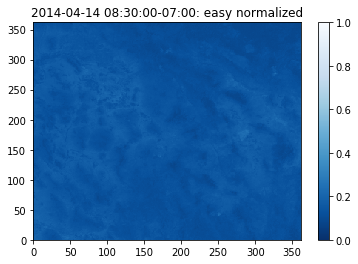

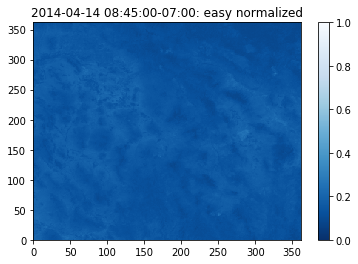

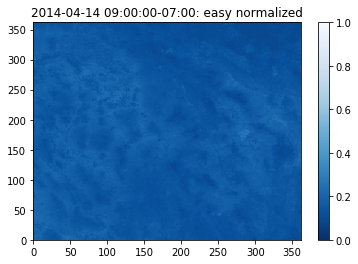

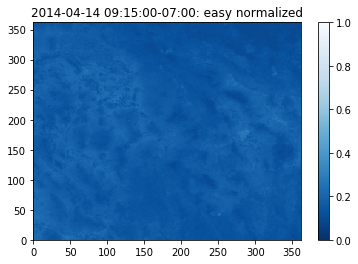

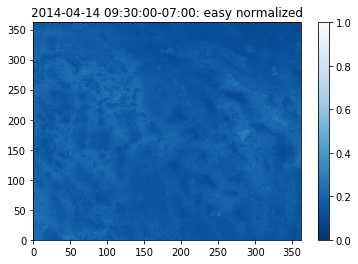

...

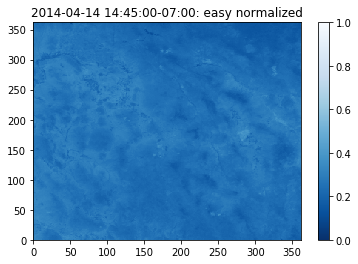

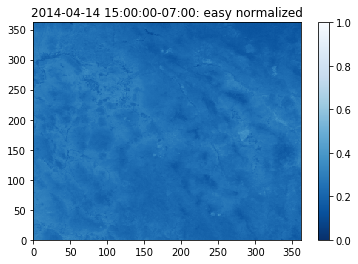

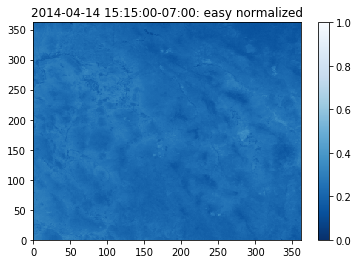

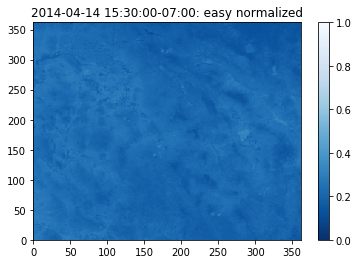

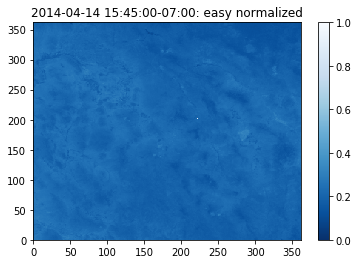

In [ ]:
for this_time in pixel.loc[this_day].index:
    this_image = pixel.loc[
        this_time].reshape(domain_shape).copy()/max_pixel
    plt.figure()
    im = plt.pcolormesh(
        this_image,
        cmap='Blues_r',
        vmin=0, vmax=1)
    plt.colorbar(im)
    plt.title(str(this_time) + ': easy normalized')

In [23]:
max_pixels = pixel.max()
min_pixels = pixel.min()

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  """Entry point for launching an IPython kernel.
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:11: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  # This is added back by InteractiveShellApp.init_path()


Text(0.5,1,'Max_pixels')

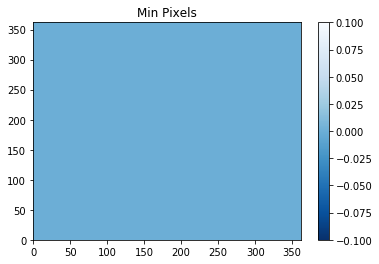

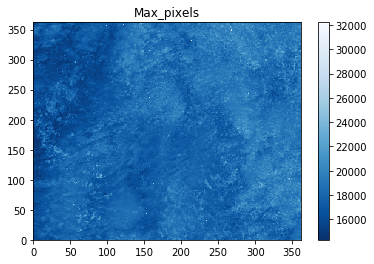

In [28]:
this_image = min_pixels.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('Min Pixels')


this_image = max_pixels.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('Max_pixels')

In [44]:
pixel = pixel.replace(to_replace=0, value=np.nan)

In [45]:
max_pixels = pixel.max()
min_pixels = pixel.min()

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  """Entry point for launching an IPython kernel.
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:11: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  # This is added back by InteractiveShellApp.init_path()


Text(0.5,1,'Max_pixels')

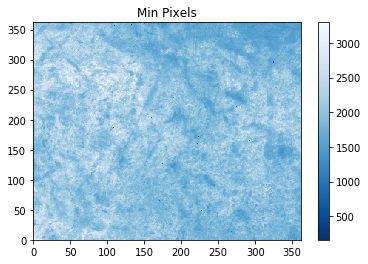

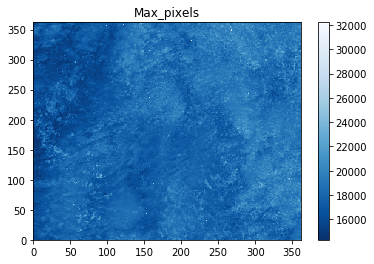

In [46]:
this_image = min_pixels.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('Min Pixels')


this_image = max_pixels.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('Max_pixels')

Text(0.5,1,'perssure')

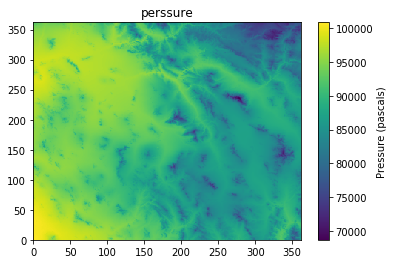

In [47]:
pressure = pv.atmosphere.alt2pres(elevation)
plt.figure()
im = plt.pcolormesh(pressure.reshape(domain_shape))
plt.colorbar(im, label='Pressure (pascals)')
plt.title('perssure')

In [88]:
app_zenith = None
sun_elevation = None
azimuth = None
for time in pixel.index:                                                                                            
    temp = pv.spa.solar_position(time.value/10**9, lats, lons, elevation,                                           
                                 pressure/100, 12, 67.0, 0.)                                                        
    if app_zenith is None:                                                                                          
        app_zenith = pd.DataFrame({time: temp[0]})                                                                  
    else:                                                                                                           
        app_zenith[time] = temp[0]
    
    if sun_elevation is None:                                                                                          
        sun_elevation = pd.DataFrame({time: temp[2]})                                                                  
    else:                                                                                                           
        sun_elevation[time] = temp[2]
        
    if azimuth is None:                                                                                          
        azimuth = pd.DataFrame({time: temp[4]})                                                                  
    else:                                                                                                           
        azimuth[time] = temp[4]

In [102]:
azimuth = azimuth.T
sun_elevation = sun_elevation.T
app_zenith = app_zenith.T

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  import sys
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


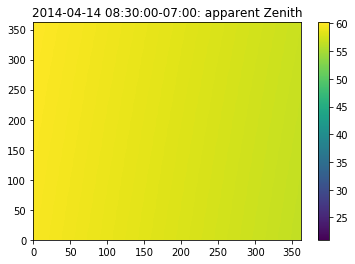

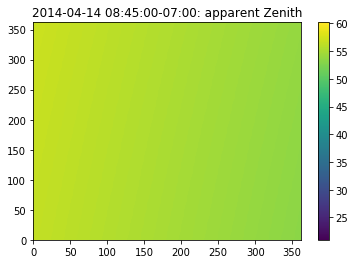

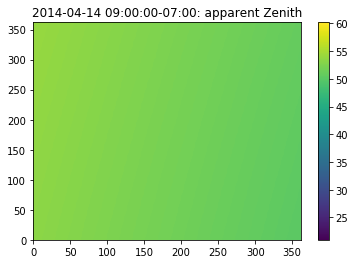

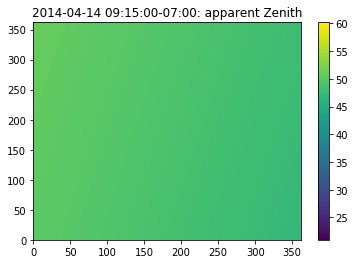

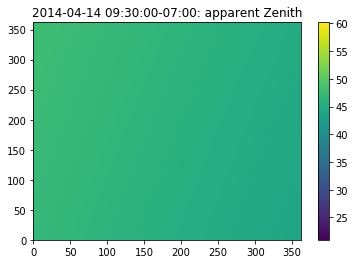

...

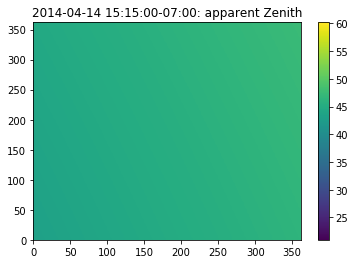

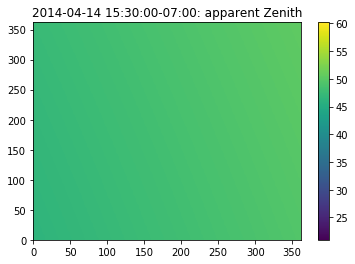

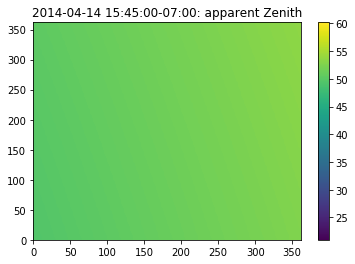

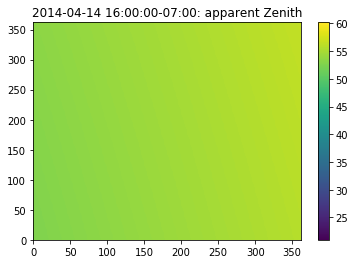

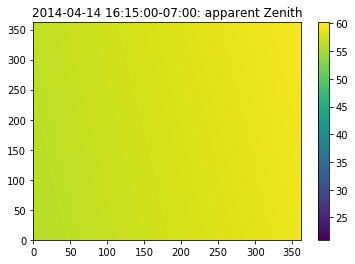

In [103]:
 
az_min = app_zenith.loc[this_day].min().min()
az_max = app_zenith.loc[this_day].max().max()
time_range = app_zenith.loc[this_day].index
for this_time in time_range:
    this_image = app_zenith.loc[
        this_time].reshape(domain_shape).copy()
    plt.figure()
    im = plt.pcolormesh(
        this_image, vmin=az_min, vmax=az_max)
    plt.colorbar(im)
    plt.title(str(this_time) + ': apparent Zenith')
    

In [18]:
am = pv.atmosphere.absoluteairmass(pv.atmosphere.relativeairmass(                                                   
        app_zenith), pressure)

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


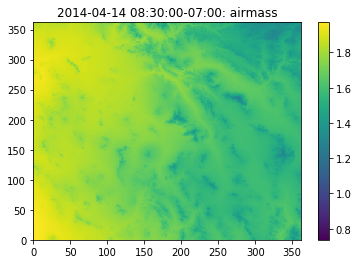

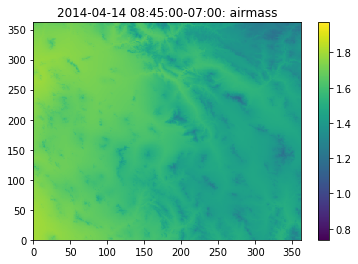

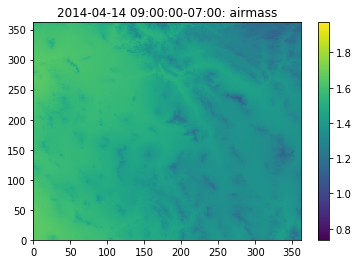

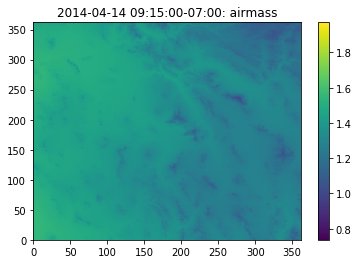

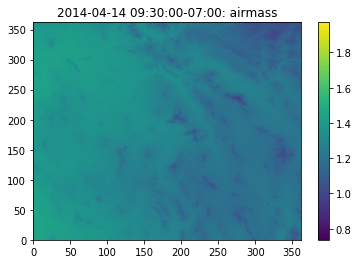

...

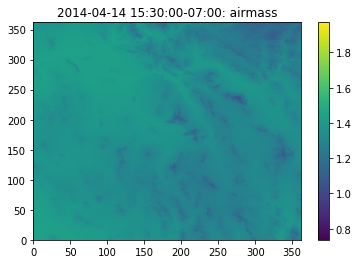

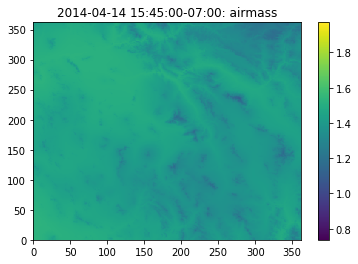

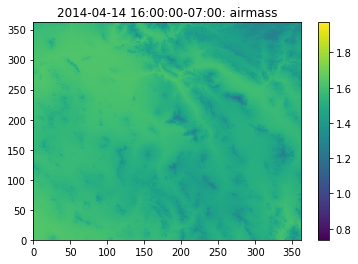

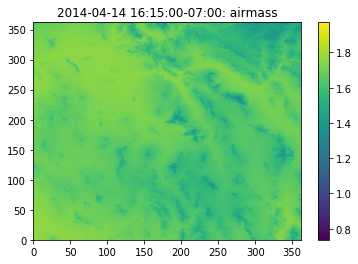

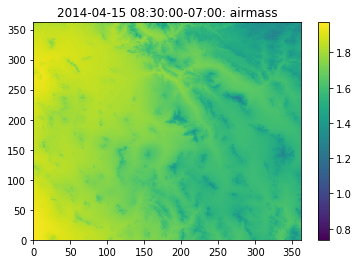

In [63]:
vmin = am[pixel.index.get_loc(this_day)].min()
vmax = am[pixel.index.get_loc(this_day)].max()
int_range = pixel.index.get_loc(this_day)
for this_int in range(int_range.start, int_range.stop + 1):
    this_time = pixel.index[this_int]
    this_image = am[this_int].reshape(domain_shape).copy()
    plt.figure()
    im = plt.pcolormesh(
        this_image,
        vmin=vmin, vmax=vmax)
    plt.colorbar(im)
    plt.title(str(this_time) + ': airmass')

In [64]:
soldist = pv.solarposition.pyephem_earthsun_distance(pixel.index).T.pow(2)

In [65]:
norpix = (pixel * am).mul(soldist, axis=0)

In [66]:
max_norpix = norpix.max()
min_norpix = norpix.min()

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  """Entry point for launching an IPython kernel.
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:11: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  # This is added back by InteractiveShellApp.init_path()


Text(0.5,1,'Max_pixels')

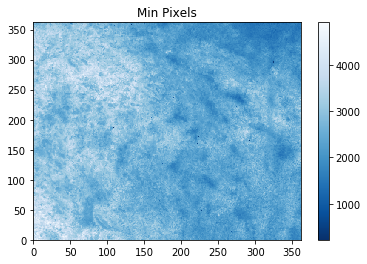

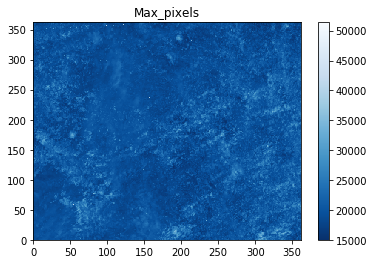

In [67]:
this_image = min_norpix.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('Min Pixels')


this_image = max_norpix.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('Max_pixels')

In [68]:
lower_number = 40
upper_bound = []                                                                                                    
lower_bound = []                                                                                                    
for c in norpix.columns:                                                                                            
    upper_bound.append(norpix[c].nlargest(20).mean())                                                               
    lower_bound.append(norpix[c].nsmallest(lower_number).mean())

In [69]:
low = pd.Series(lower_bound)
up = pd.Series(upper_bound)

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  """Entry point for launching an IPython kernel.
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:11: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  # This is added back by InteractiveShellApp.init_path()


Text(0.5,1,'High')

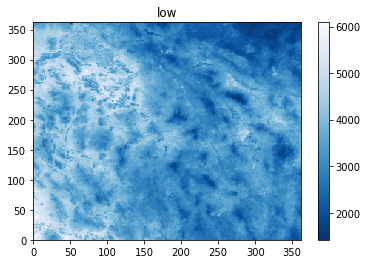

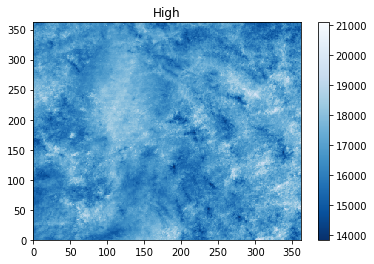

In [70]:
this_image = low.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('low')


this_image = up.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('High')

In [71]:
cloudiness_index = (norpix - low) / (up - low)

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:3: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  This is separate from the ipykernel package so we can avoid doing imports until
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


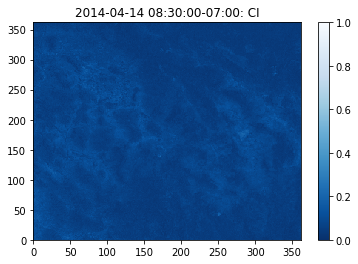

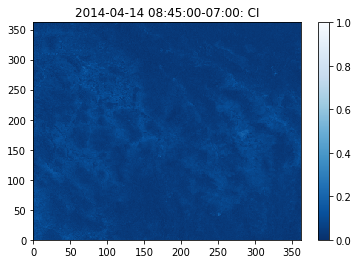

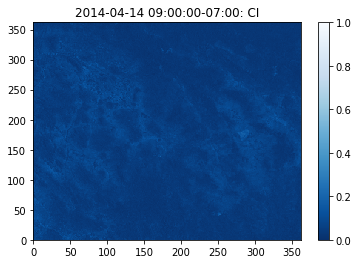

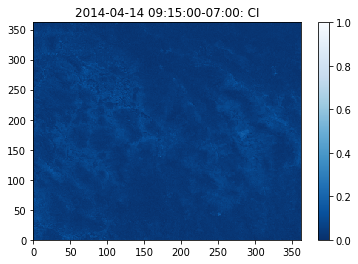

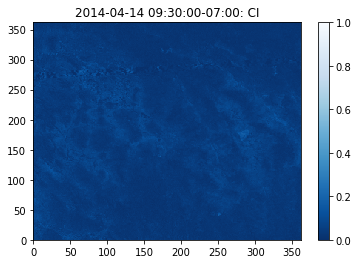

...

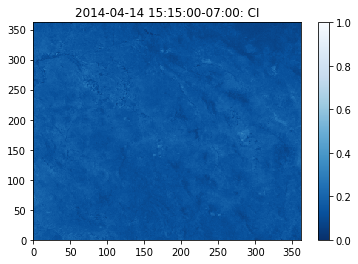

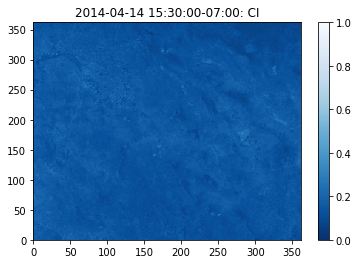

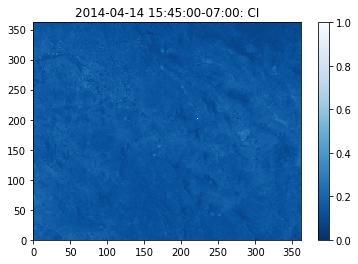

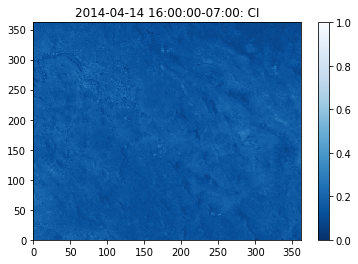

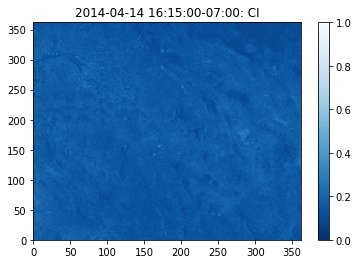

In [72]:
for this_time in cloudiness_index.loc[this_day].index:
    this_image = cloudiness_index.loc[
        this_time].reshape(domain_shape).copy()
    plt.figure()
    im = plt.pcolormesh(
        this_image,
        cmap='Blues_r',
        vmin=0, vmax=1)
    plt.colorbar(im)
    plt.title(str(this_time) + ': CI')

In [17]:
this_day = '2014-04-14'

In [18]:
pixel = pixel.replace(to_replace=0, value=np.nan)

In [19]:
max_pixels = pixel.max()
min_pixels = pixel.min()

In [20]:
max_pixel = pixel.max().mean()

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:3: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  This is separate from the ipykernel package so we can avoid doing imports until
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


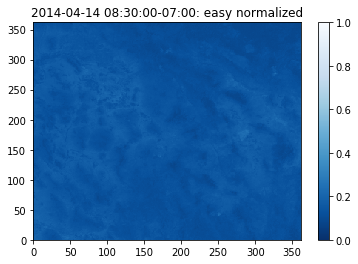

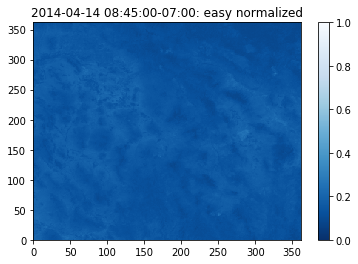

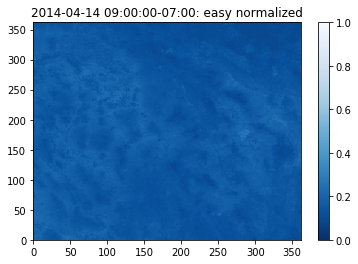

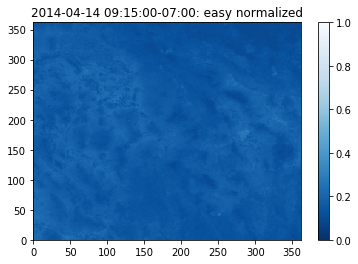

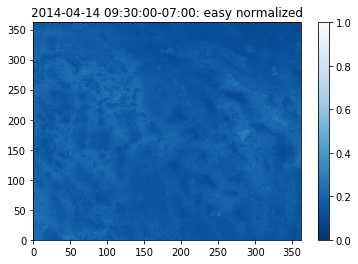

...

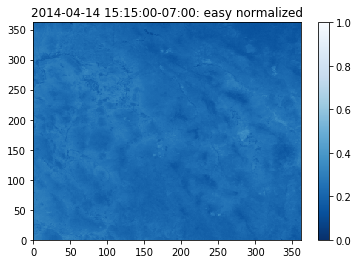

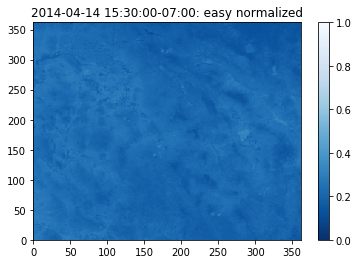

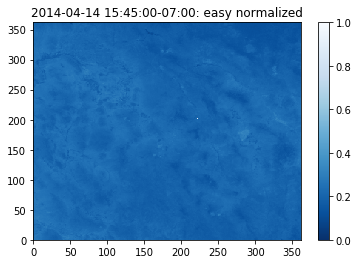

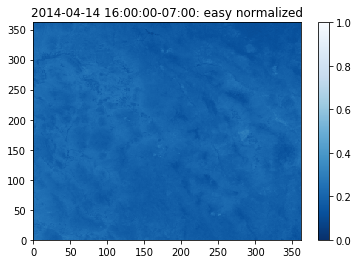

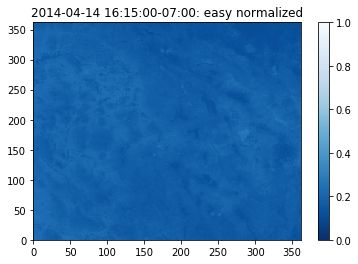

In [21]:
for this_time in pixel.loc[this_day].index:
    this_image = pixel.loc[
        this_time].reshape(domain_shape).copy()/max_pixel
    plt.figure()
    im = plt.pcolormesh(
        this_image,
        cmap='Blues_r',
        vmin=0, vmax=1)
    plt.colorbar(im)
    plt.title(str(this_time) + ': easy normalized')

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  """Entry point for launching an IPython kernel.
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:11: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  # This is added back by InteractiveShellApp.init_path()


Text(0.5,1,'Max_pixels')

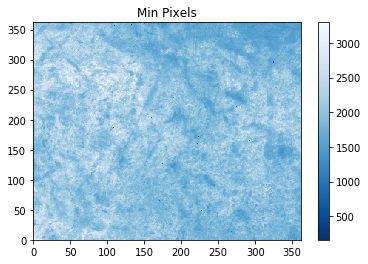

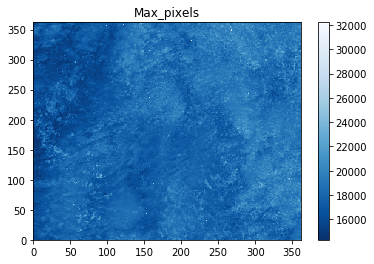

In [22]:
this_image = min_pixels.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('Min Pixels')


this_image = max_pixels.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('Max_pixels')

Text(0.5,1,'perssure')

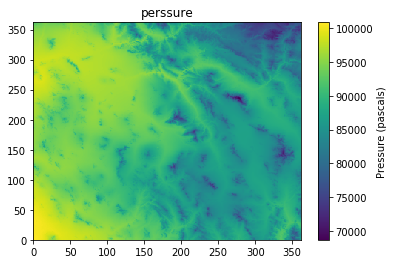

In [23]:
pressure = pv.atmosphere.alt2pres(elevation)
plt.figure()
im = plt.pcolormesh(pressure.reshape(domain_shape))
plt.colorbar(im, label='Pressure (pascals)')
plt.title('perssure')

In [24]:
app_zenith = None
sun_elevation = None
azimuth = None
for time in pixel.index:                                                                                            
    temp = pv.spa.solar_position(time.value/10**9, lats, lons, elevation,                                           
                                 pressure/100, 12, 67.0, 0.)                                                        
    if app_zenith is None:                                                                                          
        app_zenith = pd.DataFrame({time: temp[0]})                                                                  
    else:                                                                                                           
        app_zenith[time] = temp[0]
    
    if sun_elevation is None:                                                                                          
        sun_elevation = pd.DataFrame({time: temp[2]})                                                                  
    else:                                                                                                           
        sun_elevation[time] = temp[2]
        
    if azimuth is None:                                                                                          
        azimuth = pd.DataFrame({time: temp[4]})                                                                  
    else:                                                                                                           
        azimuth[time] = temp[4]

In [25]:
azimuth = azimuth.T
sun_elevation = sun_elevation.T
app_zenith = app_zenith.T

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  import sys
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


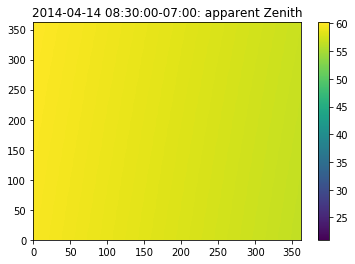

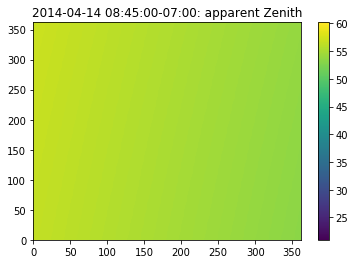

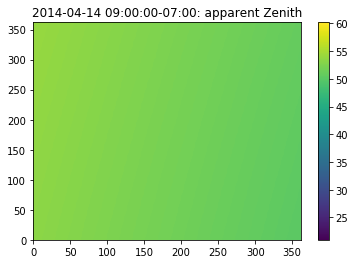

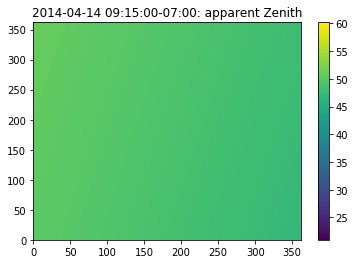

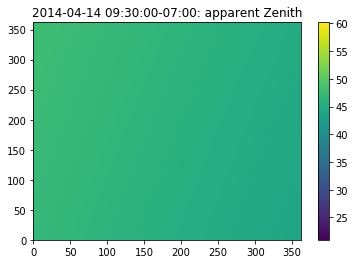

...

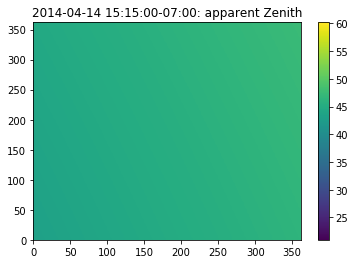

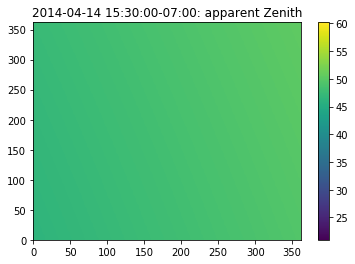

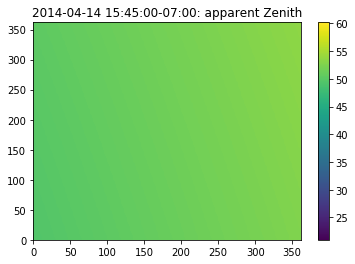

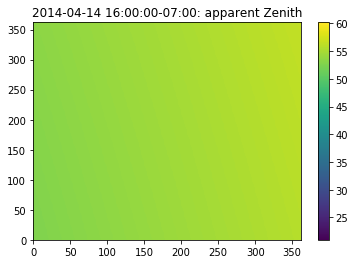

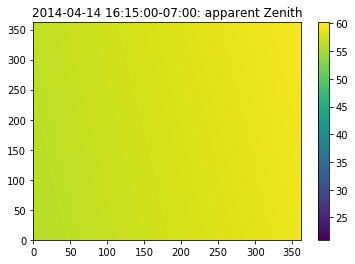

In [26]:
 
az_min = app_zenith.loc[this_day].min().min()
az_max = app_zenith.loc[this_day].max().max()
time_range = app_zenith.loc[this_day].index
for this_time in time_range:
    this_image = app_zenith.loc[
        this_time].reshape(domain_shape).copy()
    plt.figure()
    im = plt.pcolormesh(
        this_image, vmin=az_min, vmax=az_max)
    plt.colorbar(im)
    plt.title(str(this_time) + ': apparent Zenith')
    

In [27]:
am = pv.atmosphere.absoluteairmass(pv.atmosphere.relativeairmass(                                                   
        app_zenith), pressure)

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


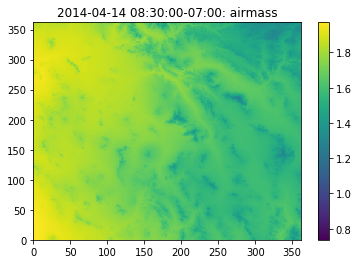

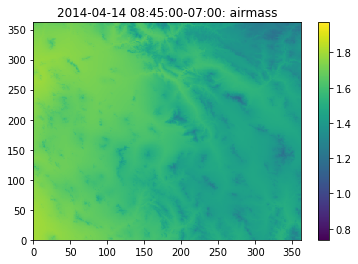

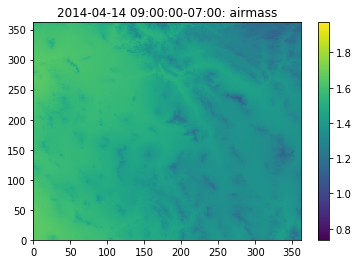

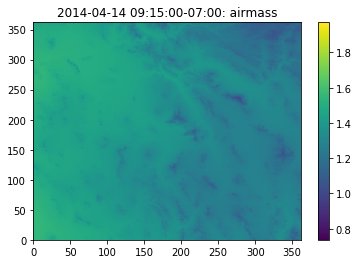

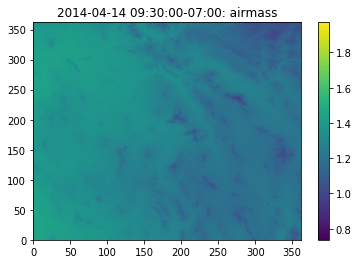

...

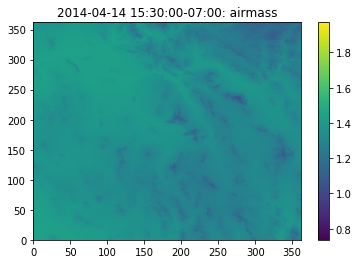

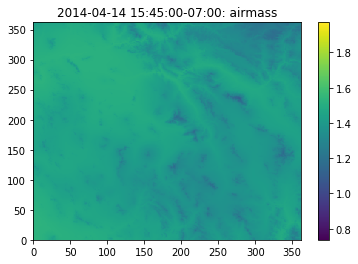

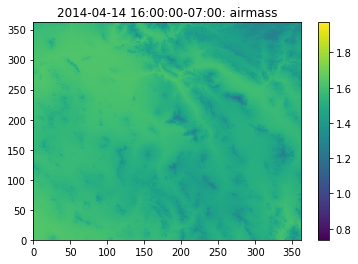

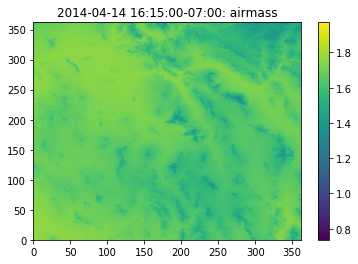

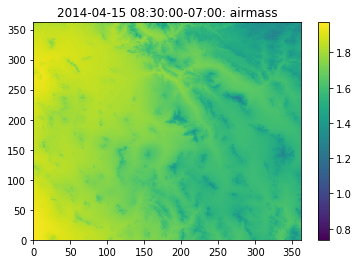

In [28]:
vmin = am[pixel.index.get_loc(this_day)].min()
vmax = am[pixel.index.get_loc(this_day)].max()
int_range = pixel.index.get_loc(this_day)
for this_int in range(int_range.start, int_range.stop + 1):
    this_time = pixel.index[this_int]
    this_image = am[this_int].reshape(domain_shape).copy()
    plt.figure()
    im = plt.pcolormesh(
        this_image,
        vmin=vmin, vmax=vmax)
    plt.colorbar(im)
    plt.title(str(this_time) + ': airmass')

In [29]:
soldist = pv.solarposition.pyephem_earthsun_distance(pixel.index).T.pow(2)

In [30]:
goes15_azimuth = 220.5
goes15_elevation = 44.1

In [31]:
def angle_between(az_0, el_0, az_1, el_1):
    az_0 = np.deg2rad(az_0)
    el_0 = np.deg2rad(el_0)
    az_1 = np.deg2rad(az_1)
    el_1 = np.deg2rad(el_1)
    
    x0 = np.cos(az_0)
    y0 = np.sin(az_0)
    z0 = np.sin(el_0)
    X0 = np.array([x0, y0, z0])
    
    shape1 = az_1.shape
    x1 = np.cos(az_1).ravel()[None, :]
    y1 = np.sin(az_1).ravel()[None, :]
    z1 = np.sin(el_1).ravel()[None, :]
    X1 = np.concatenate([x1, y1, z1], axis=0)
    
    print(X0.shape)
    print(X1.shape)
    theta = np.arccos(
        X0.dot(X1)/(np.linalg.norm(X0)*np.linalg.norm(X1, axis=0)))
    theta = np.rad2deg(theta)
    theta = theta.reshape(shape1)
    return theta

In [32]:
separation = angle_between(
        goes15_azimuth, goes15_elevation,
        azimuth.values, sun_elevation.values)

(3,)
(3, 341631708)


/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


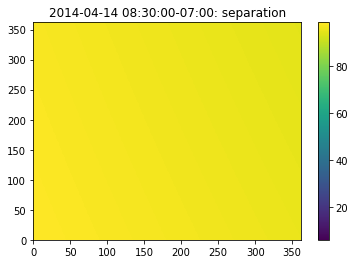

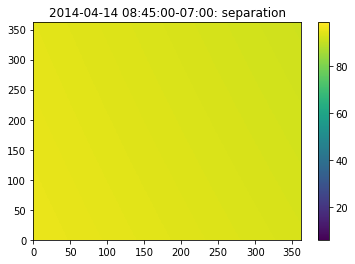

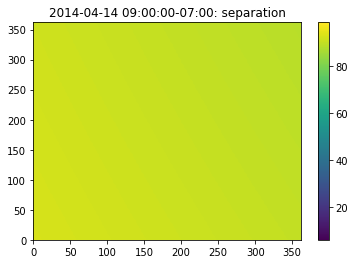

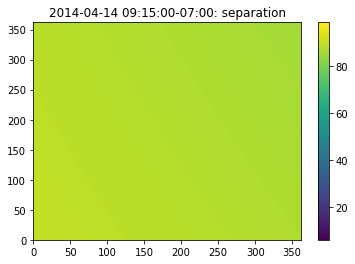

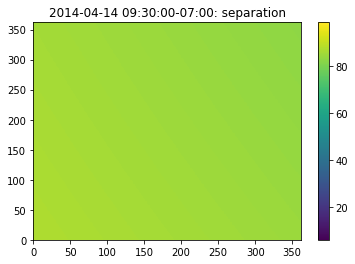

...

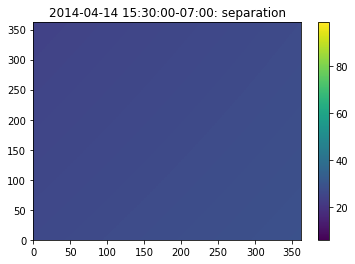

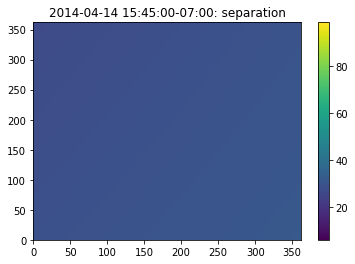

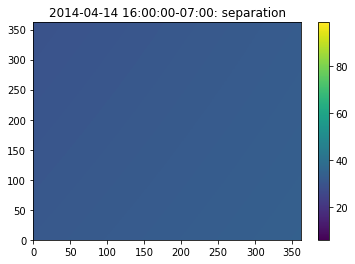

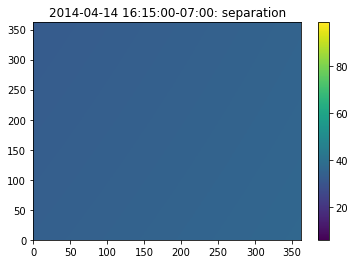

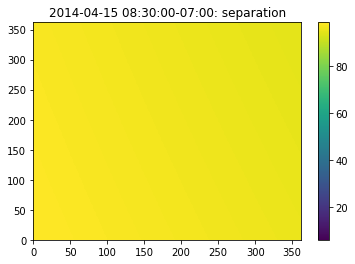

In [61]:
vmin = separation[pixel.index.get_loc(this_day)].min()
vmax = separation[pixel.index.get_loc(this_day)].max()
int_range = pixel.index.get_loc(this_day)
for this_int in range(int_range.start, int_range.stop + 1):
    this_time = pixel.index[this_int]
    this_image = separation[this_int].reshape(domain_shape).copy()
    plt.figure()
    im = plt.pcolormesh(
        this_image,
        vmin=vmin, vmax=vmax)
    plt.colorbar(im)
    plt.title(str(this_time) + ': separation')

In [73]:
def f_helio(sun_zenith):
    sun_zenith2 = np.deg2rad(sun_zenith)
    to_return = (-0.55
                 - 25.2 * np.cos(sun_zenith2)
                 - 38.3 * np.cos(sun_zenith2)**2
                 + 17.7 * np.cos(sun_zenith2)**3)
    return to_return

In [74]:
def atmospheric_offset(sep, sun_zenith, sat_zenith):
    sep2 = np.deg2rad(sep)
    sat_zenith2 = np.deg2rad(sat_zenith)
    f_array = f_helio(sun_zenith)
    to_return = (1 + np.cos(sep2)**2)*(
        f_array/np.cos(sat_zenith2)**0.78)
    return to_return

In [77]:
C_atm = atmospheric_offset(separation, 
                           90 - sun_elevation.values,
                           90 - goes15_elevation)

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


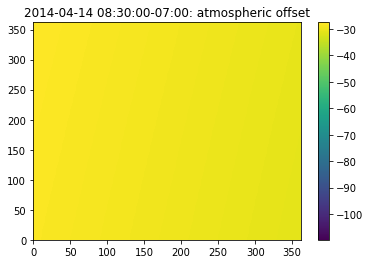

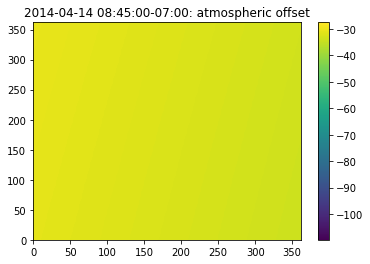

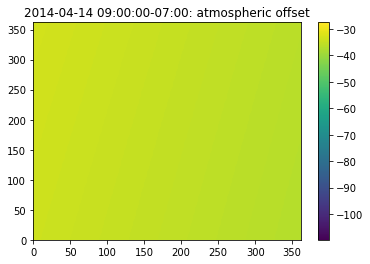

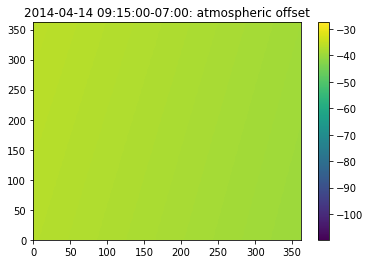

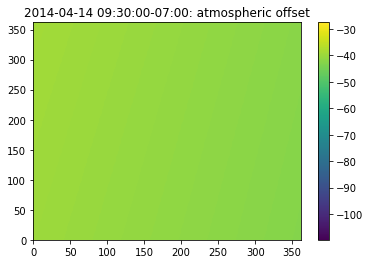

...

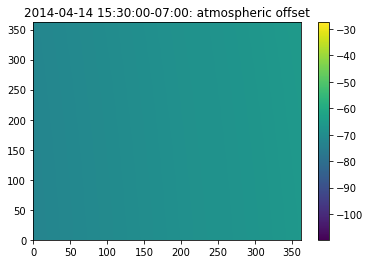

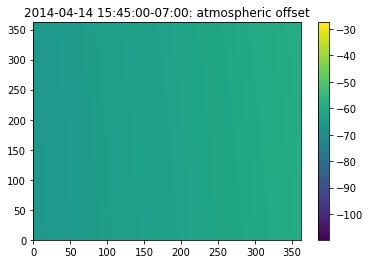

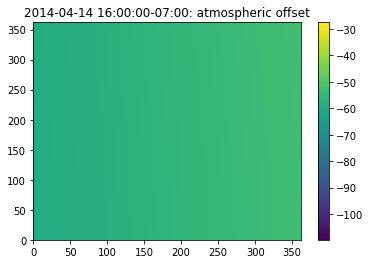

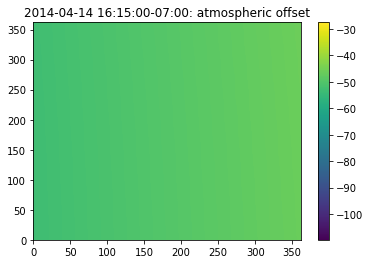

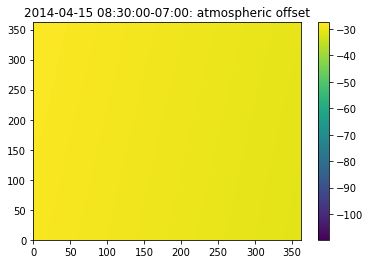

In [78]:
vmin = C_atm[pixel.index.get_loc(this_day)].min()
vmax = C_atm[pixel.index.get_loc(this_day)].max()
int_range = pixel.index.get_loc(this_day)
for this_int in range(int_range.start, int_range.stop):
    this_time = pixel.index[this_int]
    this_image = C_atm[this_int].reshape(domain_shape).copy()
    plt.figure()
    im = plt.pcolormesh(
        this_image,
        vmin=vmin, vmax=vmax)
    plt.colorbar(im)
    plt.title(str(this_time) + ': atmospheric offset')
# for this_time in C_atm.loc[this_day].index:
#     this_image = C_atm.loc[
#         this_time].reshape(domain_shape).copy()
#     plt.figure()
#     im = plt.pcolormesh(
#         this_image,
#         vmin=0, vmax=1)
#     plt.colorbar(im)
#     plt.title(str(this_time) + ': C_atm')

AttributeError: 'str' object has no attribute 'pop'

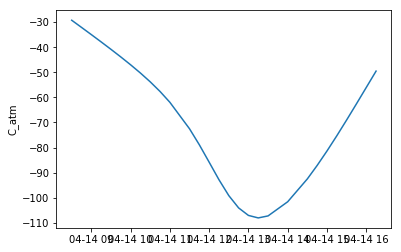

In [81]:
int_range = pixel.index.get_loc(this_day)
c_mean = C_atm[int_range].mean(axis=1)
plt.figure()
plt.plot(pixel.loc[this_day].index, c_mean)
plt.ylabel('C_atm')
plt.xlabel, 'time')

In [79]:
C_atm.shape

(2607, 131044)

In [ ]:
pixel = pixel - C_atm

In [ ]:
max_pixel = pixel.max().mean()

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:3: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  This is separate from the ipykernel package so we can avoid doing imports until
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


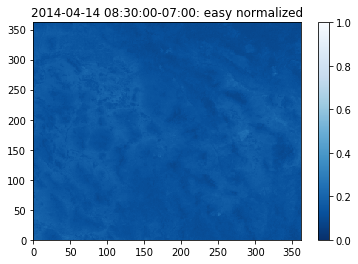

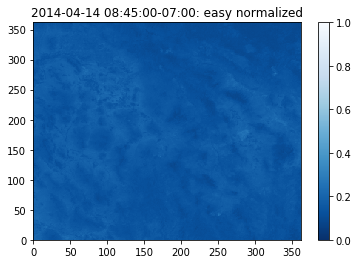

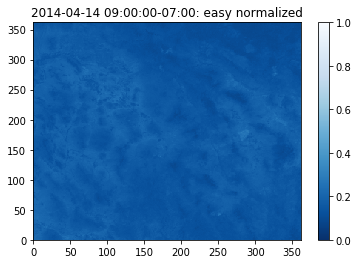

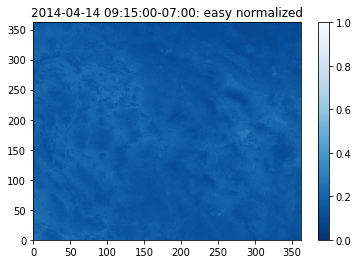

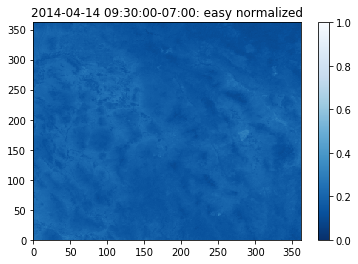

...

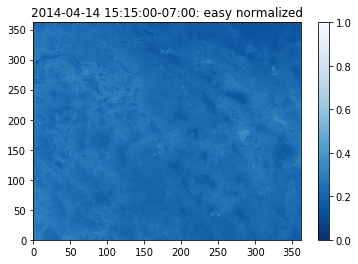

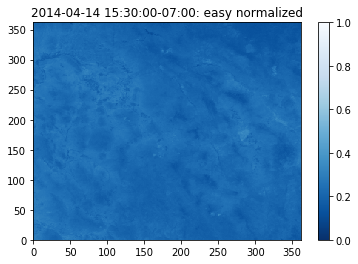

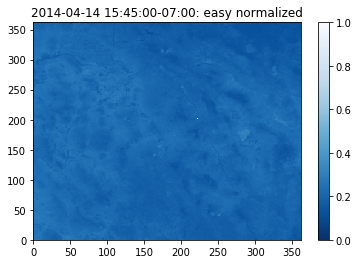

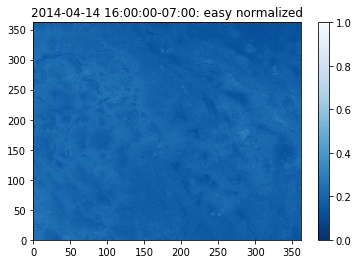

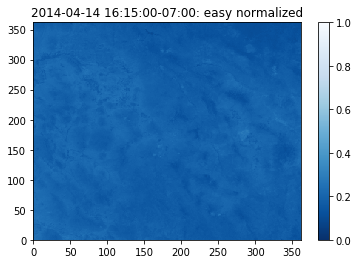

In [38]:
for this_time in pixel.loc[this_day].index:
    this_image = pixel.loc[
        this_time].reshape(domain_shape).copy()/max_pixel
    plt.figure()
    im = plt.pcolormesh(
        this_image,
        cmap='Blues_r',
        vmin=0, vmax=1)
    plt.colorbar(im)
    plt.title(str(this_time) + ': easy normalized')

In [39]:
norpix = (pixel * am).mul(soldist, axis=0)

In [40]:
max_norpix = norpix.max()
min_norpix = norpix.min()

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  """Entry point for launching an IPython kernel.
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:11: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  # This is added back by InteractiveShellApp.init_path()


Text(0.5,1,'Max_pixels')

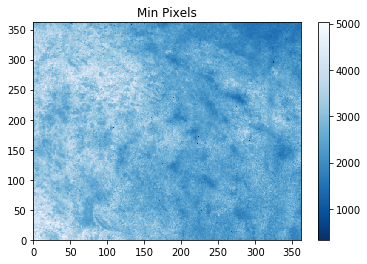

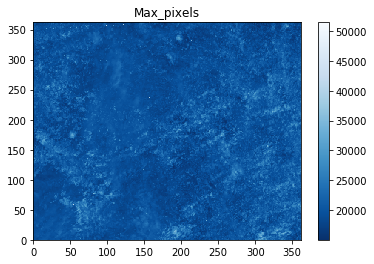

In [ ]:
this_image = min_norpix.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('Min Pixels')


this_image = max_norpix.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('Max_pixels')

In [ ]:
lower_number = 40
upper_bound = []                                                                                                    
lower_bound = []                                                                                                    
for c in norpix.columns:                                                                                            
    upper_bound.append(norpix[c].nlargest(20).mean())                                                               
    lower_bound.append(norpix[c].nsmallest(lower_number).mean())

In [ ]:
low = pd.Series(lower_bound)
up = pd.Series(upper_bound)

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  """Entry point for launching an IPython kernel.
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:11: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  # This is added back by InteractiveShellApp.init_path()


Text(0.5,1,'High')

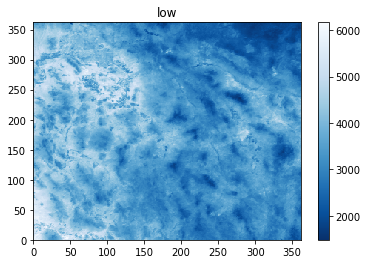

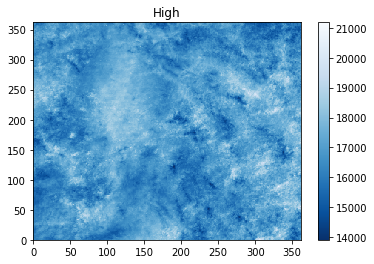

In [49]:
this_image = low.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('low')


this_image = up.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('High')

In [ ]:
cloudiness_index = (norpix - low) / (up - low)

/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/ipykernel_launcher.py:3: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  This is separate from the ipykernel package so we can avoid doing imports until
/home/travis/miniconda3/envs/py36letkf/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


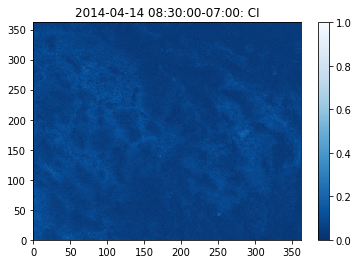

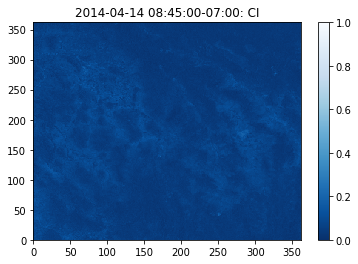

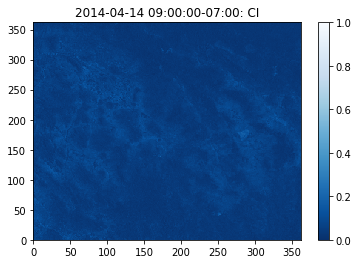

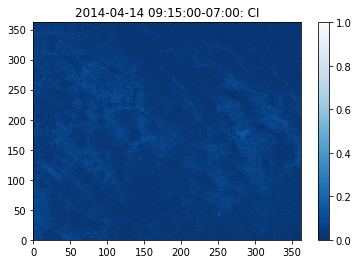

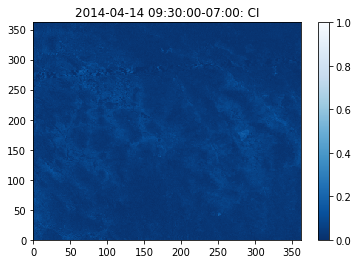

...

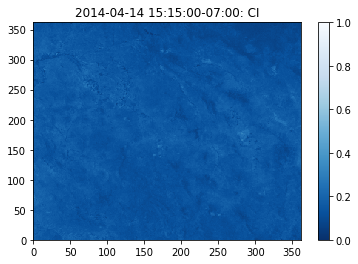

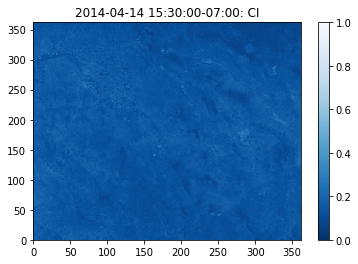

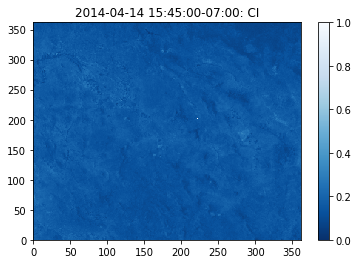

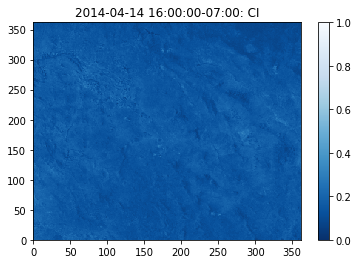

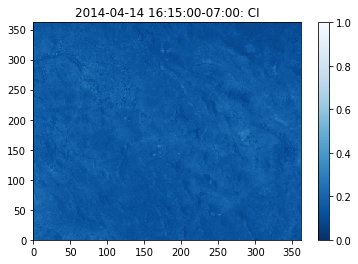

In [48]:
for this_time in cloudiness_index.loc[this_day].index:
    this_image = cloudiness_index.loc[
        this_time].reshape(domain_shape).copy()
    plt.figure()
    im = plt.pcolormesh(
        this_image,
        cmap='Blues_r',
        vmin=0, vmax=1)
    plt.colorbar(im)
    plt.title(str(this_time) + ': CI')

In [ ]:
importlib.reload(prep)
low, up, cloudiness_index = prep.get_cloudiness_index(pixel, lats, lons, elevation)

In [ ]:
np.save(save_folder + 'low', low)
np.save(save_folder + 'up', up)
cloudiness_index.to_hdf(
    save_folder + 'cloudiness_index.h5', 'cloudiness_index')

In [ ]:
low = np.load(save_folder + 'low.npy')
up = np.load(save_folder + 'up.npy')
cloudiness_index = pd.read_hdf(save_folder + 'cloudiness_index.h5')

In [ ]:
this_image = low.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('low')


this_image = up.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('High')

In [ ]:
date_range = pd.date_range(
    '2014-04-15 10:00:00', freq='15 min', periods=10).tz_localize('MST')
for this_time in cloudiness_index.loc['2014-04-15'].index:
    # this_time = pd.Timestamp('2014-04-15 12:45:00').tz_localize('MST')
    this_image = cloudiness_index.loc[this_time].reshape(domain_shape).copy()
    plt.figure()
    im = plt.pcolormesh(
        this_image,
        cmap='Blues_r',
        vmin=0, vmax=1)
    plt.colorbar(im)
    plt.title(str(this_time) + ': CI')

In [ ]:
this_image = low.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('low')


this_image = up.reshape(domain_shape).copy()
plt.figure()
im = plt.pcolormesh(
    this_image,
    cmap='Blues_r',
    vmin=None, vmax=None)
plt.colorbar(im)
plt.title('High')

In [ ]:
date_range = pd.date_range(
    '2014-04-15 10:00:00', freq='15 min', periods=10).tz_localize('MST')
vmin = pixel.loc['2014-04-15'].min().min()
vmax = pixel.loc['2014-04-15'].max().max()
for this_time in pixel.loc['2014-04-15'].index:
    # this_time = pd.Timestamp('2014-04-15 12:45:00').tz_localize('MST')
    this_image = pixel.loc[this_time].reshape(domain_shape).copy()
    plt.figure()
    im = plt.pcolormesh(
        this_image,
        cmap='Blues_r',
        vmin=vmin, vmax=vmax)
    plt.colorbar(im)

In [ ]:
date_range = pd.date_range(
    '2014-04-15 10:00:00', freq='15 min', periods=10).tz_localize('MST')
for this_time in cloudiness_index.loc['2014-04-15'].index:
    # this_time = pd.Timestamp('2014-04-15 12:45:00').tz_localize('MST')
    this_image = cloudiness_index.loc[this_time].reshape(domain_shape).copy()
    plt.figure()
    im = plt.pcolormesh(
        this_image,
        cmap='Blues_r',
        vmin=0, vmax=1)
    plt.colorbar(im)

In [ ]:
date_range = pd.date_range(
    '2014-04-15 10:00:00', freq='15 min', periods=10).tz_localize('MST')
for this_time in cloudiness_index.loc['2014-04-15'].index:
    # this_time = pd.Timestamp('2014-04-15 12:45:00').tz_localize('MST')
    this_image = cloudiness_index.loc[this_time].reshape(domain_shape).copy()
    plt.figure()
    im = plt.pcolormesh(
        this_image,
        cmap='Blues_r',
        vmin=0, vmax=1)
    plt.colorbar(im)

In [ ]:
importlib.reload(prep)
clearsky = prep.get_clearsky(pixel.index, elevation, lats, lons)

In [ ]:
clearsky.to_hdf('./data/clearsky.h5', 'clearsky')

In [ ]:
clearsky.shape

In [ ]:
this_time = pd.Timestamp('2014-04-15 12:45:00').tz_localize('MST')
CI = cloudiness_index.ix[this_time].reshape(domain_shape).copy()
ktm = 2.36*CI**5 - 6.2*CI**4 + 6.22*CI**3 - 2.63*CI**2 - 0.58*CI + 1
Ghcnew = clearsky.ix[this_time].reshape(domain_shape).copy()
GHI = ktm*Ghcnew*(0.0001*ktm*Ghcnew + 0.9)

In [ ]:
this_time = pd.Timestamp('2014-04-14 12:45:00').tz_localize('MST')
CI_c = cloudiness_index.ix[this_time].reshape(domain_shape).copy()
ktm_c = 2.36*CI_c**5 - 6.2*CI_c**4 + 6.22*CI_c**3 - 2.63*CI_c**2 - 0.58*CI_c + 1
Ghcnew_c = clearsky.ix[this_time].reshape(domain_shape).copy()
GHI_c = ktm_c*Ghcnew_c*(0.0001*ktm_c*Ghcnew_c + 0.9)

In [ ]:
plt.figure()
this_image = GHI/GHI_c
print(this_image.max() - this_image.min())
im = plt.pcolormesh(
    this_image,
    cmap='Blues',
    vmin=0, vmax=1)
plt.colorbar(im)

plt.figure()
this_image = GHI/Ghcnew
print(this_image.max() - this_image.min())
im = plt.pcolormesh(
    this_image,
    cmap='Blues',
    vmin=0, vmax=1)
plt.colorbar(im)